<a href="https://colab.research.google.com/github/kwankoravich/COVID-19-Adverse-Event-Bayesian-Network/blob/main/Covid_19_Vaccine_Moderna.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Clean the data

In [ ]:
!gdown --id 11rypkT4tLGUuKeSAjY8pgPTn2RWQfJ7c

Downloading...
From: https://drive.google.com/uc?id=11rypkT4tLGUuKeSAjY8pgPTn2RWQfJ7c
To: /content/covid-19_vaccine_Moderna.csv
100% 390k/390k [00:00<00:00, 58.5MB/s]


In [ ]:
import numpy as np
import pandas as pd
import matplotlib as plt

In [ ]:
df = pd.read_csv('covid-19_vaccine_Moderna.csv', index_col ="VAERS ID")
df.head()

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID,,,,,,,,
0919537-1,0919537-1,80+ years,80+,Female,F,PULSE ABSENT,10037469,Moderna
0921547-1,0921547-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna
0924664-1,0924664-1,80+ years,80+,Female,F,COMPUTERISED TOMOGRAM ABNORMAL,10010235,Moderna
0924664-1,0924664-1,80+ years,80+,Female,F,DEATH,10011906,Moderna
0924664-1,0924664-1,80+ years,80+,Female,F,INTRACRANIAL ANEURYSM,10022758,Moderna


Check the VAERS ID and age is uniquely associated in the dataset

In [ ]:
len(set(df['VAERS ID Code']))

1117

In [ ]:
df[(df['Age'] == '18-29 years')]

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID,,,,,,,,
1034146-1,1034146-1,18-29 years,18-29,Male,M,UNEVALUABLE EVENT,10062355,Moderna
1078352-1,1078352-1,18-29 years,18-29,Male,M,CHEST PAIN,10008479,Moderna
1078352-1,1078352-1,18-29 years,18-29,Male,M,DEATH,10011906,Moderna
1078352-1,1078352-1,18-29 years,18-29,Male,M,FATIGUE,10016256,Moderna
1078352-1,1078352-1,18-29 years,18-29,Male,M,HEADACHE,10019211,Moderna
1078352-1,1078352-1,18-29 years,18-29,Male,M,PAIN,10033371,Moderna
1078352-1,1078352-1,18-29 years,18-29,Male,M,UNRESPONSIVE TO STIMULI,10045555,Moderna
1105146-1,1105146-1,18-29 years,18-29,Male,M,ASTHENIA,10003549,Moderna
1105146-1,1105146-1,18-29 years,18-29,Male,M,DEATH,10011906,Moderna


Grouping the same symptoms

In [ ]:
#df['Symptoms'] = df['Symptoms'].replace(['SARS-COV-2 TEST POSITIVE'], 'COVID-19')
#df['Symptoms'] = df['Symptoms'].replace(['ASTHENIA'], 'FATIGUE')
#df['Symptoms'] = df['Symptoms'].replace(['RESPIRATORY FAILURE'], 'HYPOXIA')
#df['Symptoms'] = df['Symptoms'].replace(['SUDDEN DEATH'], 'DEATH')
#df['Symptoms'] = df['Symptoms'].replace(['DECREASED APPETITE'], 'HYPOPHAGIA')
#df['Symptoms'] = df['Symptoms'].replace(['COVID-19 PNEUMONIA', 'PNEUMONIA ASPIRATION', 'ATYPICAL PNEUMONIA'], 'PNEUMONIA')
#df['Symptoms'] = df['Symptoms'].replace(['PRODUCTIVE COUGH'], 'COUGH')
#df['Symptoms'] = df['Symptoms'].replace(['FEELING ABNORMAL', 'FEELING HOT', 'FEELING COLD', 'MALAISE'], 'ILLNESS')
#df['Symptoms'] = df['Symptoms'].replace(['INTENSIVE CARE', 'INTENSIVE CARE UNIT ACQUIRED WEAKNESS', 'COMA SCALE', 'COMA SCALE ABNORMA'], 'COMA')
#df['Symptoms'] = df['Symptoms'].replace(['VERTIGO'], 'DIZZINESS')

Deleting irrelevant data

In [ ]:
pd.set_option('display.max_rows', df.shape[0]+1)
df['Symptoms'].value_counts()

DEATH                                                        953
DYSPNOEA                                                     122
UNRESPONSIVE TO STIMULI                                       92
COVID-19                                                      84
CARDIAC ARREST                                                80
RESUSCITATION                                                 71
SARS-COV-2 TEST POSITIVE                                      70
FATIGUE                                                       59
ASTHENIA                                                      58
PYREXIA                                                       51
VOMITING                                                      50
FALL                                                          47
ENDOTRACHEAL INTUBATION                                       46
MALAISE                                                       43
PNEUMONIA                                                     41
NAUSEA                   

In [ ]:
g = df.groupby(['VAERS ID Code', 'Age'])

In [ ]:
g.count()

,,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID Code,Age,,,,,,
0919537-1,80+ years,1,1,1,1,1,1
0921547-1,65-79 years,1,1,1,1,1,1
0924664-1,80+ years,6,6,6,6,6,6
0926600-1,65-79 years,2,2,2,2,2,2
0928513-1,65-79 years,1,1,1,1,1,1
0929997-1,80+ years,6,6,6,6,6,6
0930154-1,60-64 years,1,1,1,1,1,1
0930876-1,80+ years,2,2,2,2,2,2
0930910-1,50-59 years,1,1,1,1,1,1


As we can see the number of row in VAERS_ID is the same number of the groupby (VAERS_ID & Age)

In [ ]:
ID_COVID = df[(df.Symptoms != 'COVID-19')].index.unique()
#ID_COVID = np.array(ID_COVID)
ID_COVID

Index(['0919537-1', '0921547-1', '0924664-1', '0926600-1', '0928513-1',
       '0929997-1', '0930154-1', '0930876-1', '0930910-1', '0933846-1',
       ...
       '1378451-1', '1382330-1', '1382493-1', '1382716-1', '1385230-1',
       '1385311-1', '1385943-1', '1387512-1', '1388528-1', '1388553-1'],
      dtype='object', name='VAERS ID', length=1117)

Exclude COVID-19 Cases by using comparing two array

In [ ]:
ID_death = df[(df.Symptoms == 'DEATH')].index.unique()
#ID_death = np.array(ID_death)
ID_death

Index(['0921547-1', '0924664-1', '0926600-1', '0928513-1', '0929997-1',
       '0930154-1', '0930876-1', '0930910-1', '0933846-1', '0934050-1',
       ...
       '1376548-1', '1376634-1', '1376795-1', '1378451-1', '1382330-1',
       '1382716-1', '1385943-1', '1387512-1', '1388528-1', '1388553-1'],
      dtype='object', name='VAERS ID', length=953)

In [ ]:
death_covid = ID_COVID.intersection(ID_death)
death_covid

Index(['0921547-1', '0924664-1', '0926600-1', '0928513-1', '0929997-1',
       '0930154-1', '0930876-1', '0930910-1', '0933846-1', '0934050-1',
       ...
       '1376548-1', '1376634-1', '1376795-1', '1378451-1', '1382330-1',
       '1382716-1', '1385943-1', '1387512-1', '1388528-1', '1388553-1'],
      dtype='object', name='VAERS ID', length=953)

In [ ]:
death_uncovid = ID_COVID[ID_COVID.isin(ID_death) == False]
death_uncovid

Index(['0919537-1', '0936043-1', '0944732-1', '0948164-1', '0956994-1',
       '0958069-1', '0958745-1', '0958971-1', '0965564-1', '0970495-1',
       ...
       '1341218-1', '1351445-1', '1364018-1', '1370350-1', '1372112-1',
       '1374761-1', '1375603-1', '1382493-1', '1385230-1', '1385311-1'],
      dtype='object', name='VAERS ID', length=164)

In [ ]:
uncovid_death = ID_death[ID_death.isin(ID_COVID) == False]
uncovid_death

Index([], dtype='object', name='VAERS ID')

In [ ]:
df[df['VAERS ID Code'] == '0921175-1']

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer
VAERS ID,,,,,,,,


In [ ]:
#ID_death = df_COVID[(df_COVID.Symptoms == 'DEATH')].index.unique()
#ID_death

In [ ]:
#df_death_covid = df_COVID[df_COVID['VAERS ID Code'].isin(ID_death)].Symptoms
#df_death_covid

Find max symptoms in death cases

In [ ]:
symp_len = {} # store the length of symptom in case of DEATH
for i in range(len(ID_death)):
  sum = 0
  x = ID_death[i]
  symp_len[x] = len(df[(df['VAERS ID Code'] == x)].Symptoms)
print(symp_len)

{'0921547-1': 1, '0924664-1': 6, '0926600-1': 2, '0928513-1': 1, '0929997-1': 6, '0930154-1': 1, '0930876-1': 2, '0930910-1': 1, '0933846-1': 5, '0934050-1': 5, '0934539-1': 6, '0935511-1': 1, '0937434-1': 1, '0937569-1': 1, '0940855-1': 1, '0940866-1': 6, '0941607-1': 4, '0941743-1': 1, '0943362-1': 3, '0944641-1': 1, '0946293-1': 3, '0947841-1': 1, '0949474-1': 3, '0949523-1': 4, '0949630-1': 7, '0950073-1': 9, '0950108-1': 3, '0950979-1': 2, '0951688-1': 1, '0952881-1': 20, '0953129-1': 5, '0953785-1': 2, '0954780-1': 3, '0955425-1': 3, '0957799-1': 8, '0958228-1': 19, '0958565-1': 3, '0959167-1': 1, '0959272-1': 1, '0959356-1': 1, '0959568-1': 6, '0961845-1': 1, '0962995-1': 1, '0963016-1': 1, '0963163-1': 1, '0963235-1': 4, '0963269-1': 1, '0963388-1': 1, '0963610-1': 2, '0964401-1': 1, '0965807-1': 5, '0965831-1': 1, '0965922-1': 1, '0966359-1': 4, '0966844-1': 3, '0967506-1': 1, '0967747-1': 1, '0968195-1': 10, '0968707-1': 1, '0969363-1': 9, '0969636-1': 5, '0969699-1': 1, '097

In [ ]:
def max_symp(dict):
  max_value = 0
  max_value = max(dict.values())
  for i, j in dict.items():
    if j == max_value:
      return i
      break
max_symp(symp_len)

'1034349-1'

In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len)].Symptoms.unique()

array(['ACTIVATED PARTIAL THROMBOPLASTIN TIME',
       'ALANINE AMINOTRANSFERASE NORMAL', 'ANION GAP',
       'ASPARTATE AMINOTRANSFERASE INCREASED', 'BASOPHIL COUNT NORMAL',
       'BASOPHIL PERCENTAGE', 'BLOOD ALBUMIN NORMAL',
       'BLOOD ALKALINE PHOSPHATASE NORMAL', 'BLOOD BICARBONATE DECREASED',
       'BLOOD BICARBONATE INCREASED', 'BLOOD BILIRUBIN NORMAL',
       'BLOOD CALCIUM NORMAL', 'BLOOD CHLORIDE INCREASED',
       'BLOOD CHLORIDE NORMAL', 'BLOOD CREATININE INCREASED',
       'BLOOD GASES ABNORMAL', 'BLOOD GLUCOSE INCREASED',
       'BLOOD MAGNESIUM INCREASED', 'BLOOD METHAEMOGLOBIN',
       'BLOOD POTASSIUM NORMAL', 'BLOOD SODIUM DECREASED',
       'BLOOD UREA NORMAL', 'CARBON DIOXIDE DECREASED',
       'CARBOXYHAEMOGLOBIN DECREASED', 'CONFUSIONAL STATE', 'DEATH',
       'DIFFERENTIAL WHITE BLOOD CELL COUNT', 'ELECTROCARDIOGRAM NORMAL',
       'EOSINOPHIL COUNT NORMAL', 'EOSINOPHIL PERCENTAGE',
       'FIBRIN D DIMER INCREASED', 'FRACTION OF INSPIRED OXYGEN',
       'FU

Find max symptoms of undeath cases

In [ ]:
ID_before_alive = df[(df.Symptoms != 'DEATH')].index.unique()
#ID_death = np.array(ID_death)
ID_before_alive

Index(['0919537-1', '0924664-1', '0926600-1', '0929997-1', '0930876-1',
       '0933846-1', '0934050-1', '0934539-1', '0936043-1', '0940866-1',
       ...
       '1376795-1', '1378451-1', '1382330-1', '1382493-1', '1382716-1',
       '1385230-1', '1385311-1', '1385943-1', '1387512-1', '1388528-1'],
      dtype='object', name='VAERS ID', length=775)

In [ ]:
ID_alive = ID_before_alive[ID_before_alive.isin(ID_death) == False]
ID_alive

Index(['0919537-1', '0936043-1', '0944732-1', '0948164-1', '0956994-1',
       '0958069-1', '0958745-1', '0958971-1', '0965564-1', '0970495-1',
       ...
       '1341218-1', '1351445-1', '1364018-1', '1370350-1', '1372112-1',
       '1374761-1', '1375603-1', '1382493-1', '1385230-1', '1385311-1'],
      dtype='object', name='VAERS ID', length=164)

In [ ]:
symp_len_alive = {} # store the length of symptom in case of DEATH
for i in range(len(ID_alive)):
  sum = 0
  y = ID_alive[i]
  symp_len_alive[y] = len(df[(df['VAERS ID Code'] == y)].Symptoms)
print(symp_len_alive)

{'0919537-1': 1, '0936043-1': 1, '0944732-1': 2, '0948164-1': 11, '0956994-1': 3, '0958069-1': 3, '0958745-1': 6, '0958971-1': 3, '0965564-1': 1, '0970495-1': 1, '0972148-1': 3, '0974833-1': 21, '0974960-1': 7, '0976146-1': 1, '0982541-1': 7, '0985814-1': 30, '0992342-1': 6, '0995825-1': 4, '0996423-1': 2, '0998228-1': 1, '0998544-1': 1, '1008041-1': 4, '1013145-1': 2, '1015465-1': 4, '1017339-1': 7, '1018146-1': 1, '1024539-1': 5, '1025330-1': 3, '1026233-1': 2, '1026752-1': 4, '1027967-1': 2, '1029335-1': 1, '1029511-1': 1, '1029554-1': 1, '1032252-1': 2, '1032265-1': 3, '1032279-1': 2, '1032303-1': 5, '1032321-1': 1, '1034146-1': 1, '1036881-1': 1, '1040170-1': 21, '1041333-1': 3, '1046881-1': 1, '1048786-1': 7, '1049963-1': 5, '1050431-1': 5, '1053694-1': 1, '1056518-1': 1, '1057750-1': 10, '1057828-1': 1, '1061184-1': 9, '1061909-1': 1, '1065507-1': 3, '1067358-1': 10, '1069009-1': 6, '1074361-1': 1, '1074401-1': 1, '1075639-1': 20, '1080433-1': 1, '1080932-1': 3, '1082850-1': 9, 

In [ ]:
def max_symp(dict):
  max_value = 0
  max_value = max(dict.values())
  for i, j in dict.items():
    if j == max_value:
      return i
      break
max_symp(symp_len_alive)

'1137286-1'

In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len_alive)].Symptoms.unique()

array(['ACUTE KIDNEY INJURY', 'ACUTE MYOCARDIAL INFARCTION', 'APHASIA',
       'ARTHRALGIA', 'BACK PAIN',
       'BLOOD CREATINE PHOSPHOKINASE INCREASED', 'BLOOD CULTURE POSITIVE',
       'BLOOD GASES ABNORMAL', 'BODY TEMPERATURE INCREASED',
       'C-REACTIVE PROTEIN INCREASED', 'CHILLS',
       'COMPUTERISED TOMOGRAM ABNORMAL', 'CSF CELL COUNT INCREASED',
       'CSF GLUCOSE INCREASED', 'CSF LYMPHOCYTE COUNT',
       'CSF NEUTROPHIL COUNT INCREASED', 'CSF PROTEIN INCREASED',
       'DELIRIUM', 'ECHOCARDIOGRAM', 'ECHOCARDIOGRAM ABNORMAL',
       'ENDOCARDITIS', 'HAEMATOCRIT DECREASED', 'HAEMOGLOBIN DECREASED',
       'HYPERHIDROSIS', 'HYPERTHERMIA',
       'IMMATURE GRANULOCYTE COUNT INCREASED',
       'JOINT RANGE OF MOTION DECREASED', 'LYMPHOCYTE COUNT DECREASED',
       'MAGNETIC RESONANCE IMAGING HEAD ABNORMAL',
       'MEAN PLATELET VOLUME INCREASED', 'MENTAL STATUS CHANGES',
       'MOBILITY DECREASED', 'MYALGIA', 'NEUTROPHIL COUNT INCREASED',
       'PLATELET COUNT DECREASED', 

In [ ]:
df[df['VAERS ID Code'] == '0926269-1'].Symptoms.unique()

array([], dtype=object)

# Ranking the occurence of symptom

In [ ]:
len(df['Symptoms'].unique())

940

In [ ]:
df_symptom = df['Symptoms']
df_symptom.value_counts().head(5)

DEATH                      953
DYSPNOEA                   122
UNRESPONSIVE TO STIMULI     92
COVID-19                    84
CARDIAC ARREST              80
Name: Symptoms, dtype: int64

In [ ]:
df_symptom_top5 = df_symptom.value_counts().head(5)
df_symptom_top20 = df_symptom.value_counts().head(20)
print(df_symptom_top5.index)

Index(['DEATH', 'DYSPNOEA', 'UNRESPONSIVE TO STIMULI', 'COVID-19',
       'CARDIAC ARREST'],
      dtype='object')


In [ ]:
for i in df_symptom:
  arr = []
  for j in range(len(df_symptom)):
    if df_symptom[j] == i:
      arr.append(1)
    else:
      arr.append(0)
  df[i] = arr
df

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,PULSE ABSENT,DEATH,COMPUTERISED TOMOGRAM ABNORMAL,INTRACRANIAL ANEURYSM,PULMONARY OEDEMA,UNRESPONSIVE TO STIMULI,X-RAY ABNORMAL,MALAISE,DYSPHAGIA,FEEDING DISORDER,LETHARGY,MOBILITY DECREASED,SPEECH DISORDER,X-RAY WITH CONTRAST,BACK PAIN,CARDIAC DISORDER,DIZZINESS,PAIN IN EXTREMITY,FALL,POSTURE ABNORMAL,RESUSCITATION,AUTOPSY,BLOOD TEST,CULTURE TISSUE SPECIMEN,TOXICOLOGIC TEST,ABNORMAL BEHAVIOUR,CARDIAC ARREST,CARDIO-RESPIRATORY ARREST,ANAL INCONTINENCE,HYPOTONIA,SYNCOPE,ACUTE RESPIRATORY FAILURE,...,PERIPHERAL ARTERY THROMBOSIS,AORTIC ANEURYSM REPAIR,DEVICE DISLOCATION,CENTRAL NERVOUS SYSTEM LESION,CRANIOTOMY,INTRACRANIAL PRESSURE INCREASED,LUMBAR PUNCTURE,VENTRICULO-PERITONEAL SHUNT,EMBOLISM,BRAIN STEM HAEMORRHAGE,ANURIA,LIVER DISORDER,CARDIOMYOPATHY,HAEMOPHILUS INFECTION,HAEMOPHILUS TEST POSITIVE,VACCINE BREAKTHROUGH INFECTION,ELECTROCARDIOGRAM ST SEGMENT,HAEMODYNAMIC TEST,AMMONIA DECREASED,ANGIOGRAM CEREBRAL NORMAL,ARTERIOGRAM CAROTID NORMAL,BLOOD ALCOHOL NORMAL,POLLAKIURIA,GENE SEQUENCING,GUILLAIN-BARRE SYNDROME,IMMUNOGLOBULIN THERAPY,LUMBAR PUNCTURE ABNORMAL,MUSCLE ATROPHY,IRON DEFICIENCY ANAEMIA,PULMONARY HAEMORRHAGE,SUPERINFECTION BACTERIAL,ATRIAL ENLARGEMENT,GALLBLADDER DISORDER,NEUROLOGICAL DECOMPENSATION,PULMONARY INFARCTION,SCAN WITH CONTRAST ABNORMAL,THROMBECTOMY,ULTRASOUND DOPPLER,ULTRASOUND SCAN NORMAL,VENTRICULAR ENLARGEMENT
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0919537-1,0919537-1,80+ years,80+,Female,F,PULSE ABSENT,10037469,Moderna,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921547-1,0921547-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,COMPUTERISED TOMOGRAM ABNORMAL,10010235,Moderna,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,INTRACRANIAL ANEURYSM,10022758,Moderna,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,PULMONARY OEDEMA,10037423,Moderna,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,UNRESPONSIVE TO STIMULI,10045555,Moderna,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,X-RAY ABNORMAL,10048065,Moderna,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926600-1,0926600-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df[df['VAERS ID Code']=='0921768-1']

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,PULSE ABSENT,DEATH,COMPUTERISED TOMOGRAM ABNORMAL,INTRACRANIAL ANEURYSM,PULMONARY OEDEMA,UNRESPONSIVE TO STIMULI,X-RAY ABNORMAL,MALAISE,DYSPHAGIA,FEEDING DISORDER,LETHARGY,MOBILITY DECREASED,SPEECH DISORDER,X-RAY WITH CONTRAST,BACK PAIN,CARDIAC DISORDER,DIZZINESS,PAIN IN EXTREMITY,FALL,POSTURE ABNORMAL,RESUSCITATION,AUTOPSY,BLOOD TEST,CULTURE TISSUE SPECIMEN,TOXICOLOGIC TEST,ABNORMAL BEHAVIOUR,CARDIAC ARREST,CARDIO-RESPIRATORY ARREST,ANAL INCONTINENCE,HYPOTONIA,SYNCOPE,ACUTE RESPIRATORY FAILURE,...,PERIPHERAL ARTERY THROMBOSIS,AORTIC ANEURYSM REPAIR,DEVICE DISLOCATION,CENTRAL NERVOUS SYSTEM LESION,CRANIOTOMY,INTRACRANIAL PRESSURE INCREASED,LUMBAR PUNCTURE,VENTRICULO-PERITONEAL SHUNT,EMBOLISM,BRAIN STEM HAEMORRHAGE,ANURIA,LIVER DISORDER,CARDIOMYOPATHY,HAEMOPHILUS INFECTION,HAEMOPHILUS TEST POSITIVE,VACCINE BREAKTHROUGH INFECTION,ELECTROCARDIOGRAM ST SEGMENT,HAEMODYNAMIC TEST,AMMONIA DECREASED,ANGIOGRAM CEREBRAL NORMAL,ARTERIOGRAM CAROTID NORMAL,BLOOD ALCOHOL NORMAL,POLLAKIURIA,GENE SEQUENCING,GUILLAIN-BARRE SYNDROME,IMMUNOGLOBULIN THERAPY,LUMBAR PUNCTURE ABNORMAL,MUSCLE ATROPHY,IRON DEFICIENCY ANAEMIA,PULMONARY HAEMORRHAGE,SUPERINFECTION BACTERIAL,ATRIAL ENLARGEMENT,GALLBLADDER DISORDER,NEUROLOGICAL DECOMPENSATION,PULMONARY INFARCTION,SCAN WITH CONTRAST ABNORMAL,THROMBECTOMY,ULTRASOUND DOPPLER,ULTRASOUND SCAN NORMAL,VENTRICULAR ENLARGEMENT
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [ ]:
df_undrup = df.drop_duplicates(subset=['VAERS ID Code'], keep='first')
df_undrup

,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,PULSE ABSENT,DEATH,COMPUTERISED TOMOGRAM ABNORMAL,INTRACRANIAL ANEURYSM,PULMONARY OEDEMA,UNRESPONSIVE TO STIMULI,X-RAY ABNORMAL,MALAISE,DYSPHAGIA,FEEDING DISORDER,LETHARGY,MOBILITY DECREASED,SPEECH DISORDER,X-RAY WITH CONTRAST,BACK PAIN,CARDIAC DISORDER,DIZZINESS,PAIN IN EXTREMITY,FALL,POSTURE ABNORMAL,RESUSCITATION,AUTOPSY,BLOOD TEST,CULTURE TISSUE SPECIMEN,TOXICOLOGIC TEST,ABNORMAL BEHAVIOUR,CARDIAC ARREST,CARDIO-RESPIRATORY ARREST,ANAL INCONTINENCE,HYPOTONIA,SYNCOPE,ACUTE RESPIRATORY FAILURE,...,PERIPHERAL ARTERY THROMBOSIS,AORTIC ANEURYSM REPAIR,DEVICE DISLOCATION,CENTRAL NERVOUS SYSTEM LESION,CRANIOTOMY,INTRACRANIAL PRESSURE INCREASED,LUMBAR PUNCTURE,VENTRICULO-PERITONEAL SHUNT,EMBOLISM,BRAIN STEM HAEMORRHAGE,ANURIA,LIVER DISORDER,CARDIOMYOPATHY,HAEMOPHILUS INFECTION,HAEMOPHILUS TEST POSITIVE,VACCINE BREAKTHROUGH INFECTION,ELECTROCARDIOGRAM ST SEGMENT,HAEMODYNAMIC TEST,AMMONIA DECREASED,ANGIOGRAM CEREBRAL NORMAL,ARTERIOGRAM CAROTID NORMAL,BLOOD ALCOHOL NORMAL,POLLAKIURIA,GENE SEQUENCING,GUILLAIN-BARRE SYNDROME,IMMUNOGLOBULIN THERAPY,LUMBAR PUNCTURE ABNORMAL,MUSCLE ATROPHY,IRON DEFICIENCY ANAEMIA,PULMONARY HAEMORRHAGE,SUPERINFECTION BACTERIAL,ATRIAL ENLARGEMENT,GALLBLADDER DISORDER,NEUROLOGICAL DECOMPENSATION,PULMONARY INFARCTION,SCAN WITH CONTRAST ABNORMAL,THROMBECTOMY,ULTRASOUND DOPPLER,ULTRASOUND SCAN NORMAL,VENTRICULAR ENLARGEMENT
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0919537-1,0919537-1,80+ years,80+,Female,F,PULSE ABSENT,10037469,Moderna,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921547-1,0921547-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,COMPUTERISED TOMOGRAM ABNORMAL,10010235,Moderna,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926600-1,0926600-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928513-1,0928513-1,65-79 years,65-79,Female,F,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0929997-1,0929997-1,80+ years,80+,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930154-1,0930154-1,60-64 years,60-64,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930876-1,0930876-1,80+ years,80+,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930910-1,0930910-1,50-59 years,50-59,Female,F,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
col = df.columns
col = np.array(col)
col
symtomps = col[8:]
symtomps

array(['PULSE ABSENT', 'DEATH', 'COMPUTERISED TOMOGRAM ABNORMAL',
       'INTRACRANIAL ANEURYSM', 'PULMONARY OEDEMA',
       'UNRESPONSIVE TO STIMULI', 'X-RAY ABNORMAL', 'MALAISE',
       'DYSPHAGIA', 'FEEDING DISORDER', 'LETHARGY', 'MOBILITY DECREASED',
       'SPEECH DISORDER', 'X-RAY WITH CONTRAST', 'BACK PAIN',
       'CARDIAC DISORDER', 'DIZZINESS', 'PAIN IN EXTREMITY', 'FALL',
       'POSTURE ABNORMAL', 'RESUSCITATION', 'AUTOPSY', 'BLOOD TEST',
       'CULTURE TISSUE SPECIMEN', 'TOXICOLOGIC TEST',
       'ABNORMAL BEHAVIOUR', 'CARDIAC ARREST',
       'CARDIO-RESPIRATORY ARREST', 'ANAL INCONTINENCE', 'HYPOTONIA',
       'SYNCOPE', 'ACUTE RESPIRATORY FAILURE', 'HYPOXIA',
       'ABDOMINAL PAIN', 'CHEST PAIN', 'CHEST X-RAY',
       'COMPUTERISED TOMOGRAM', 'COMPUTERISED TOMOGRAM ABDOMEN',
       'CONFUSIONAL STATE', 'DECREASED APPETITE', 'FULL BLOOD COUNT',
       'HEADACHE', 'HEPATIC ENZYME INCREASED', 'METABOLIC FUNCTION TEST',
       'RESPIRATORY ARREST', 'VOMITING',
       'GENE

In [ ]:
df.index.unique()

Index(['0919537-1', '0921547-1', '0924664-1', '0926600-1', '0928513-1',
       '0929997-1', '0930154-1', '0930876-1', '0930910-1', '0933846-1',
       ...
       '1378451-1', '1382330-1', '1382493-1', '1382716-1', '1385230-1',
       '1385311-1', '1385943-1', '1387512-1', '1388528-1', '1388553-1'],
      dtype='object', name='VAERS ID', length=1117)

In [ ]:
for i in df.index.unique():
  x = 0
  for j in symtomps: 
    x = 0
    x = df.loc[i,j].sum() #sum the value in the same ID for each symptoms
    #print(x)
    df_undrup.loc[i,j] = x
df_undrup

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,VAERS ID Code,Age,Age Code,Sex,Sex Code,Symptoms,Symptoms Code,Vaccine Manufacturer,PULSE ABSENT,DEATH,COMPUTERISED TOMOGRAM ABNORMAL,INTRACRANIAL ANEURYSM,PULMONARY OEDEMA,UNRESPONSIVE TO STIMULI,X-RAY ABNORMAL,MALAISE,DYSPHAGIA,FEEDING DISORDER,LETHARGY,MOBILITY DECREASED,SPEECH DISORDER,X-RAY WITH CONTRAST,BACK PAIN,CARDIAC DISORDER,DIZZINESS,PAIN IN EXTREMITY,FALL,POSTURE ABNORMAL,RESUSCITATION,AUTOPSY,BLOOD TEST,CULTURE TISSUE SPECIMEN,TOXICOLOGIC TEST,ABNORMAL BEHAVIOUR,CARDIAC ARREST,CARDIO-RESPIRATORY ARREST,ANAL INCONTINENCE,HYPOTONIA,SYNCOPE,ACUTE RESPIRATORY FAILURE,...,PERIPHERAL ARTERY THROMBOSIS,AORTIC ANEURYSM REPAIR,DEVICE DISLOCATION,CENTRAL NERVOUS SYSTEM LESION,CRANIOTOMY,INTRACRANIAL PRESSURE INCREASED,LUMBAR PUNCTURE,VENTRICULO-PERITONEAL SHUNT,EMBOLISM,BRAIN STEM HAEMORRHAGE,ANURIA,LIVER DISORDER,CARDIOMYOPATHY,HAEMOPHILUS INFECTION,HAEMOPHILUS TEST POSITIVE,VACCINE BREAKTHROUGH INFECTION,ELECTROCARDIOGRAM ST SEGMENT,HAEMODYNAMIC TEST,AMMONIA DECREASED,ANGIOGRAM CEREBRAL NORMAL,ARTERIOGRAM CAROTID NORMAL,BLOOD ALCOHOL NORMAL,POLLAKIURIA,GENE SEQUENCING,GUILLAIN-BARRE SYNDROME,IMMUNOGLOBULIN THERAPY,LUMBAR PUNCTURE ABNORMAL,MUSCLE ATROPHY,IRON DEFICIENCY ANAEMIA,PULMONARY HAEMORRHAGE,SUPERINFECTION BACTERIAL,ATRIAL ENLARGEMENT,GALLBLADDER DISORDER,NEUROLOGICAL DECOMPENSATION,PULMONARY INFARCTION,SCAN WITH CONTRAST ABNORMAL,THROMBECTOMY,ULTRASOUND DOPPLER,ULTRASOUND SCAN NORMAL,VENTRICULAR ENLARGEMENT
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0919537-1,0919537-1,80+ years,80+,Female,F,PULSE ABSENT,10037469,Moderna,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921547-1,0921547-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,0924664-1,80+ years,80+,Female,F,COMPUTERISED TOMOGRAM ABNORMAL,10010235,Moderna,0,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926600-1,0926600-1,65-79 years,65-79,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928513-1,0928513-1,65-79 years,65-79,Female,F,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0929997-1,0929997-1,80+ years,80+,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930154-1,0930154-1,60-64 years,60-64,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930876-1,0930876-1,80+ years,80+,Male,M,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930910-1,0930910-1,50-59 years,50-59,Female,F,DEATH,10011906,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_undrup[(df_undrup['COVID-19']==0) & (df_undrup['DEATH']==1)].index.unique()

Index(['0921547-1', '0924664-1', '0926600-1', '0928513-1', '0929997-1',
       '0930154-1', '0930876-1', '0930910-1', '0933846-1', '0934050-1',
       ...
       '1373090-1', '1373292-1', '1376548-1', '1376634-1', '1376795-1',
       '1382330-1', '1382716-1', '1387512-1', '1388528-1', '1388553-1'],
      dtype='object', name='VAERS ID', length=886)

In [ ]:
df_undrup_final = df_undrup.drop(columns=['VAERS ID Code', 'Age Code','Sex Code', 'Symptoms','Symptoms Code'])
df_undrup_final

,Age,Sex,Vaccine Manufacturer,PULSE ABSENT,DEATH,COMPUTERISED TOMOGRAM ABNORMAL,INTRACRANIAL ANEURYSM,PULMONARY OEDEMA,UNRESPONSIVE TO STIMULI,X-RAY ABNORMAL,MALAISE,DYSPHAGIA,FEEDING DISORDER,LETHARGY,MOBILITY DECREASED,SPEECH DISORDER,X-RAY WITH CONTRAST,BACK PAIN,CARDIAC DISORDER,DIZZINESS,PAIN IN EXTREMITY,FALL,POSTURE ABNORMAL,RESUSCITATION,AUTOPSY,BLOOD TEST,CULTURE TISSUE SPECIMEN,TOXICOLOGIC TEST,ABNORMAL BEHAVIOUR,CARDIAC ARREST,CARDIO-RESPIRATORY ARREST,ANAL INCONTINENCE,HYPOTONIA,SYNCOPE,ACUTE RESPIRATORY FAILURE,HYPOXIA,ABDOMINAL PAIN,CHEST PAIN,CHEST X-RAY,COMPUTERISED TOMOGRAM,...,PERIPHERAL ARTERY THROMBOSIS,AORTIC ANEURYSM REPAIR,DEVICE DISLOCATION,CENTRAL NERVOUS SYSTEM LESION,CRANIOTOMY,INTRACRANIAL PRESSURE INCREASED,LUMBAR PUNCTURE,VENTRICULO-PERITONEAL SHUNT,EMBOLISM,BRAIN STEM HAEMORRHAGE,ANURIA,LIVER DISORDER,CARDIOMYOPATHY,HAEMOPHILUS INFECTION,HAEMOPHILUS TEST POSITIVE,VACCINE BREAKTHROUGH INFECTION,ELECTROCARDIOGRAM ST SEGMENT,HAEMODYNAMIC TEST,AMMONIA DECREASED,ANGIOGRAM CEREBRAL NORMAL,ARTERIOGRAM CAROTID NORMAL,BLOOD ALCOHOL NORMAL,POLLAKIURIA,GENE SEQUENCING,GUILLAIN-BARRE SYNDROME,IMMUNOGLOBULIN THERAPY,LUMBAR PUNCTURE ABNORMAL,MUSCLE ATROPHY,IRON DEFICIENCY ANAEMIA,PULMONARY HAEMORRHAGE,SUPERINFECTION BACTERIAL,ATRIAL ENLARGEMENT,GALLBLADDER DISORDER,NEUROLOGICAL DECOMPENSATION,PULMONARY INFARCTION,SCAN WITH CONTRAST ABNORMAL,THROMBECTOMY,ULTRASOUND DOPPLER,ULTRASOUND SCAN NORMAL,VENTRICULAR ENLARGEMENT
VAERS ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0919537-1,80+ years,Female,Moderna,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0921547-1,65-79 years,Male,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0924664-1,80+ years,Female,Moderna,0,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0926600-1,65-79 years,Male,Moderna,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0928513-1,65-79 years,Female,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0929997-1,80+ years,Male,Moderna,0,1,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930154-1,60-64 years,Male,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930876-1,80+ years,Male,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0930910-1,50-59 years,Female,Moderna,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
#rows = np.random.choice(df_undrup_final[df_undrup_final['DEATH'] == 1].index, 77)
#df_undrup_final_death = df_undrup_final.loc[rows]
#df_undrup_final_death

In [ ]:
#rows = np.random.choice(df_undrup_final[df_undrup_final['DEATH'] == 0].index, 77)
#df_undrup_final_live = df_undrup_final.loc[rows]
#df_undrup_final_live

In [ ]:
#df_undrup_final = pd.concat([df_undrup_final_live, df_undrup_final_death])
#df_undrup_final = df_undrup_final.iloc[np.random.permutation(len(df_undrup_final))]
#df_undrup_final

#Model Training

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier, export_graphviz

In [ ]:
# Train Test Split
X_train, X_test, y_train, y_test = train_test_split(df_undrup_final.loc[:, 'DYSPNOEA':'PNEUMONIA'], df_undrup_final[['DEATH']], test_size=0.2, random_state=101)

In [ ]:
dt = DecisionTreeClassifier()
clf_dt=dt.fit(X_train, y_train)

In [ ]:
clf_dt.score(X_test, y_test)

0.8348214285714286

#Bayesian model

In [ ]:
from scipy import stats
import arviz as az
import numpy as np
import matplotlib.pyplot as plt
import pymc3 as pm
import seaborn as sns
import pandas as pd
from theano import shared
from sklearn import preprocessing

In [ ]:
with pm.Model() as model_g:
    μ = pm.Uniform('μ', lower=0, upper=1)
    σ = pm.HalfNormal('σ', sd=1)
    y = pm.Normal('y', mu=μ, sd=σ, observed=df_undrup_final['DEATH'].values)
    trace_g = pm.sample(1000, tune=1000)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  """
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [σ, μ]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 2 seconds.


Got error No model on context stack. trying to find log_likelihood in translation.
/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3_3x.py:102: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,
Got error No model on context stack. trying to find log_likelihood in translation.


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f2dd712e890>,
      dtype=object)

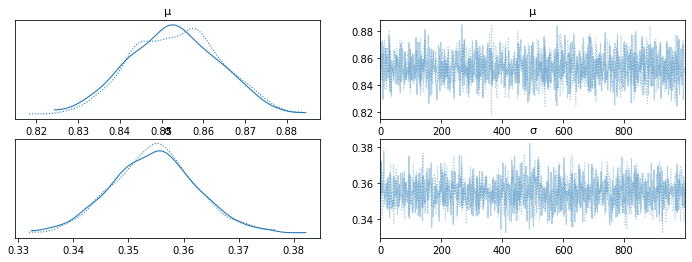

In [ ]:
az.plot_trace(trace_g)

/usr/local/lib/python3.7/dist-packages/arviz/plots/jointplot.py:145: UserWarning: plot_joint will be deprecated. Please use plot_pair instead.
  warnings.warn("plot_joint will be deprecated. Please use plot_pair instead.")
Got error No model on context stack. trying to find log_likelihood in translation.
/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3_3x.py:102: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


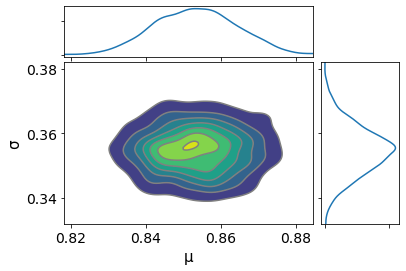

In [ ]:
az.plot_joint(trace_g, kind='kde', fill_last=False);

In [ ]:
az.summary(trace_g)

Got error No model on context stack. trying to find log_likelihood in translation.
/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3_3x.py:102: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ,0.853,0.011,0.833,0.872,0.0,0.0,1871.0,1428.0,1.01
σ,0.355,0.008,0.341,0.370,0.0,0.0,1860.0,1658.0,1.00


Got error No model on context stack. trying to find log_likelihood in translation.
/usr/local/lib/python3.7/dist-packages/arviz/data/io_pymc3_3x.py:102: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f2dcdf8b110>,
      dtype=object)

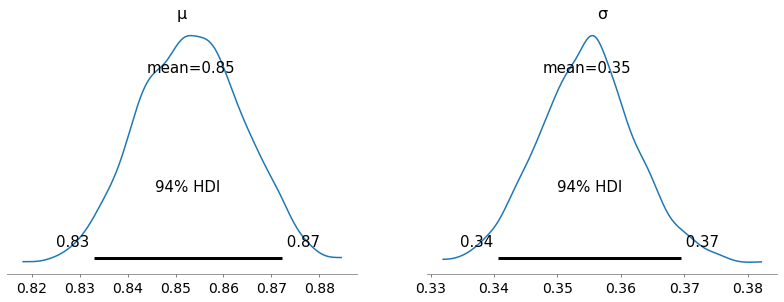

In [ ]:
az.plot_posterior(trace_g)

In [ ]:
ppc = pm.sample_posterior_predictive(trace_g, samples=1000, model=model_g)
np.asarray(ppc['y']).shape

/usr/local/lib/python3.7/dist-packages/pymc3/sampling.py:1690: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  "samples parameter is smaller than nchains times ndraws, some draws "


(1000, 1117)

[Text(0, 0.5, 'Frequency'),
 Text(0.5, 0, 'mean(x)'),
 Text(0.5, 1.0, 'Posterior predictive of the mean')]

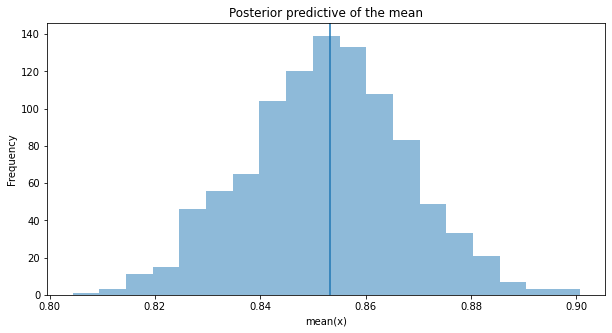

In [ ]:
_, ax = plt.subplots(figsize=(10, 5))
ax.hist([y.mean() for y in ppc['y']], bins=19, alpha=0.5)
ax.axvline(df_undrup_final['DEATH'].mean())
ax.set(title='Posterior predictive of the mean', xlabel='mean(x)', ylabel='Frequency')

#Bayesian Network

In [ ]:
pip install pybbn

  Created wheel for pybbn: filename=pybbn-3.2.1-py3-none-any.whl size=39726 sha256=3b82b29b3b5d99e14a3720712f985a124c630b064b8088b3ae273ff38e84e27b
  Stored in directory: /root/.cache/pip/wheels/a8/64/55/b52530d41fe7c9ae501ddd7c06f3122ceb5f15921680f0371b
Successfully built pybbn


In [ ]:
import networkx as nx # for drawing graphs

# for creating Bayesian Belief Networks (BBN)
from pybbn.graph.dag import Bbn
from pybbn.graph.edge import Edge, EdgeType
from pybbn.graph.jointree import EvidenceBuilder
from pybbn.graph.node import BbnNode
from pybbn.graph.variable import Variable
from pybbn.pptc.inferencecontroller import InferenceController

In [ ]:
# This function helps to calculate probability distribution, which goes into BBN (note, can handle up to 2 parents)
def probs(data, child, parent1=None, parent2=None):
    # Initialize empty list
    prob=[]
    if parent1==None:
        # Calculate probabilities
        prob=data[child].value_counts(normalize=True, sort=False).sort_index().tolist()
    elif parent1!=None:
            # Check if child node has 1 parent or 2 parents
            if parent2==None:
                # Work out the bands present in the parent variable
                bands=df[parent1].value_counts(sort=False).sort_index().index.tolist()
                # Caclucate probabilities
                for val in bands:
                    temp=data[data[parent1]==val][child].value_counts(normalize=True).sort_index().tolist()
                    prob=prob+temp
            else:    
                # Work out the bands present in the parent variable
                bands1=df[parent1].value_counts(sort=False).sort_index().index.tolist()
                bands2=df[parent2].value_counts(sort=False).sort_index().index.tolist()
                # Caclucate probabilities
                for val1 in bands1:
                    for val2 in bands2:
                        #print(val1)
                        #print(val2)
                        temp=data[(data[parent1]==val1) & (data[parent2]==val2)][child].value_counts(normalize=True).sort_index().tolist()
                        prob=prob+temp
    else: print("Error in Probability Frequency Calculations")
    
    if (child != None) & (parent1 == None) & (parent2 == None):
      i = len(prob)
      while i != len(data[child].unique()):
        prob.extend([0])
        i+=1
    
    if (parent1 != None) & (parent2 == None):
      i = len(prob)
      while i != len(data[child].unique()) * len(data[parent1].unique()): 
        prob.extend([0]) 
        i+=1

    if (parent1 != None) & (parent2 != None):
      i = len(prob)
      while i != len(data[child].unique()) * len(data[parent1].unique()) * len(data[parent2].unique()):
        prob.extend([0])
        i+=1
    return prob  

In [ ]:
probs(df_undrup_final, child = 'CARDIAC ARREST', parent1='COMA', parent2='RESUSCITATION')

[0.9492337164750958,
 0.05076628352490421,
 0.6197183098591549,
 0.38028169014084506,
 1.0,
 0,
 0,
 0]

In [ ]:
df_undrup_final['DYSPNOEA'].unique()

array([0, 1])

In [ ]:
#df[df['VAERS ID Code'] == max_symp(symp_len_alive)].Symptoms.unique()

In [ ]:
# Create nodes by using our earlier function to automatically calculate probabilities
AGE = BbnNode(Variable(0, 'AGE', df_undrup_final.Age.unique()), probs(df_undrup_final, child = 'Age'))
DY = BbnNode(Variable(1, 'DYSPNOEA', df_undrup_final['DYSPNOEA'].map(str).unique()), probs(df_undrup_final, child='DYSPNOEA', parent1= 'PNEUMONIA'))
PN = BbnNode(Variable(2, 'PNEUMONIA', df_undrup_final['PNEUMONIA'].map(str).unique()), probs(df_undrup_final, child='PNEUMONIA', parent1='COVID-19'))
DT = BbnNode(Variable(3, 'DEATH', df_undrup_final['DEATH'].map(str).unique()), probs(df_undrup_final, child='DEATH', parent1='DYSPNOEA', parent2 = 'CARDIAC ARREST'))
SEX = BbnNode(Variable(4, 'SEX', df_undrup_final.Sex.unique()), probs(df_undrup_final, child = 'Sex'))
COV = BbnNode(Variable(5, 'COVID-19', df_undrup_final['COVID-19'].map(str).unique()), probs(df_undrup_final, child = 'COVID-19', parent1='Sex', parent2='Age'))
COMA = BbnNode(Variable(6, 'COMA', df_undrup_final['COMA'].map(str).unique()), probs(df_undrup_final, child = 'COMA', parent1='UNRESPONSIVE TO STIMULI'))
CA = BbnNode(Variable(7, 'CARDIAC ARREST', df_undrup_final['CARDIAC ARREST'].map(str).unique()), probs(df_undrup_final, child = 'CARDIAC ARREST', parent1='COMA', parent2='RESUSCITATION'))
RES = BbnNode(Variable(8, 'RESUSCITATION', df_undrup_final['RESUSCITATION'].map(str).unique()), probs(df_undrup_final, child = 'RESUSCITATION'))
UNRES = BbnNode(Variable(9, 'UNRESPONSIVE TO STIMULI', df_undrup_final['UNRESPONSIVE TO STIMULI'].map(str).unique()), probs(df_undrup_final, child = 'UNRESPONSIVE TO STIMULI'))


# Create Network
bbn = Bbn() \
    .add_node(AGE) \
    .add_node(SEX) \
    .add_node(COV) \
    .add_node(COMA) \
    .add_node(RES) \
    .add_node(UNRES) \
    .add_node(PN) \
    .add_node(DY) \
    .add_node(CA) \
    .add_node(DT) \
    .add_edge(Edge(SEX, COV, EdgeType.DIRECTED)) \
    .add_edge(Edge(AGE, COV, EdgeType.DIRECTED)) \
    .add_edge(Edge(UNRES, COMA, EdgeType.DIRECTED)) \
    .add_edge(Edge(COMA, CA, EdgeType.DIRECTED)) \
    .add_edge(Edge(RES, CA, EdgeType.DIRECTED)) \
    .add_edge(Edge(COV, PN, EdgeType.DIRECTED)) \
    .add_edge(Edge(PN, DY, EdgeType.DIRECTED))\
    .add_edge(Edge(CA, DT, EdgeType.DIRECTED))\
    .add_edge(Edge(DY, DT, EdgeType.DIRECTED))

# Convert the BBN to a join tree
join_tree = InferenceController.apply(bbn)

In [ ]:
# Set node positions
#pos = {0: (-1, 2), 1: (-1, 0.5), 2: (1, 0.5), 3: (0, -1), 4:(1,1)}

# Set options for graph looks
#options = {
#    "font_size": 12,
#    "node_size": 4000,
#    "node_color": "white",
#    "edgecolors": "black",
#    "edge_color": "red",
#   "linewidths": 5,
#    "width": 5,}
    
# Generate graph
#n, d = bbn.to_nx_graph()
#nx.draw(n, with_labels=True, labels=d, pos=pos, **options)

# Update margins and print the graph
#ax = plt.gca()
#ax.margins(0.10)
#plt.axis("off")
#plt.show()

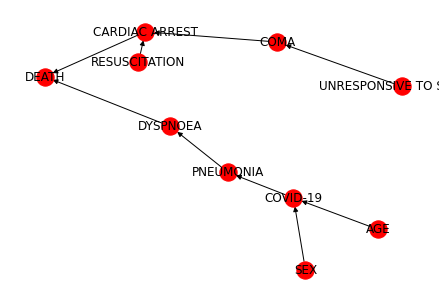

In [ ]:
import networkx as nx
n, d = bbn.to_nx_graph()
nx.draw(n, with_labels=True, labels=d, node_color='r', alpha=1.0)

In [ ]:
# Define a function for printing marginal probabilities
def print_probs():
    for node in join_tree.get_bbn_nodes():
        potential = join_tree.get_bbn_potential(node)
        print("Node:", node)
        print("Values:")
        print(potential)
        print('----------------')
        
# Use the above function to print marginal probabilities
print_probs()

Node: 6|COMA|0,1
Values:
6=0|0.99832
6=1|0.00168
----------------
Node: 9|UNRESPONSIVE TO STIMULI|0,1
Values:
9=0|0.91763
9=1|0.08237
----------------
Node: 1|DYSPNOEA|0,1
Values:
1=0|0.88968
1=1|0.11032
----------------
Node: 7|CARDIAC ARREST|0,1
Values:
7=0|0.92841
7=1|0.07159
----------------
Node: 3|DEATH|0,1
Values:
3=0|0.14802
3=1|0.85198
----------------
Node: 8|RESUSCITATION|0,1
Values:
8=0|0.93654
8=1|0.06346
----------------
Node: 2|PNEUMONIA|0,1
Values:
2=0|0.95542
2=1|0.04458
----------------
Node: 5|COVID-19|0,1
Values:
5=0|0.80042
5=1|0.19958
----------------
Node: 4|SEX|Female,Male
Values:
4=Female|0.43250
4=Male|0.56750
----------------
Node: 0|AGE|80+ years,65-79 years,60-64 years,50-59 years,40-49 years,18-29 years,30-39 years
Values:
0=80+ years|0.01969
0=65-79 years|0.02246
0=60-64 years|0.04070
0=50-59 years|0.19993
0=40-49 years|0.13334
0=18-29 years|0.58388
0=30-39 years|0.00000
----------------


In [ ]:
# print the posterior probabilities
for node, posteriors in join_tree.get_posteriors().items():
 p = ', '.join([f'{val}={prob:.5f}' for val, prob in posteriors.items()])
 print(f'{node} : {p}')

COMA : 0=0.99832, 1=0.00168
UNRESPONSIVE TO STIMULI : 0=0.91763, 1=0.08237
DYSPNOEA : 0=0.88968, 1=0.11032
CARDIAC ARREST : 0=0.92841, 1=0.07159
DEATH : 0=0.14802, 1=0.85198
RESUSCITATION : 0=0.93654, 1=0.06346
PNEUMONIA : 0=0.95542, 1=0.04458
COVID-19 : 0=0.80042, 1=0.19958
SEX : Female=0.43250, Male=0.56750
AGE : 80+ years=0.01969, 65-79 years=0.02246, 60-64 years=0.04070, 50-59 years=0.19993, 40-49 years=0.13334, 18-29 years=0.58388, 30-39 years=0.00000


In [ ]:
# To add evidence of events that happened so probability distribution can be recalculated
def evidence(ev, nod, cat, val):
    ev = EvidenceBuilder() \
    .with_node(join_tree.get_bbn_node_by_name(nod)) \
    .with_evidence(cat, val) \
    .build()
    join_tree.set_observation(ev)
    
# Use above function to add evidence
evidence('ev1','SEX','Male', 1.0)
evidence('ev1','AGE','80+ years', 1.0)
#evidence('ev1','COMA','0', 1.0)
evidence('ev1','UNRESPONSIVE TO STIMULI','1', 1.0)
#evidence('ev1','RESUSCITATION','0', 1.0)
#evidence('ev1','CARDIAC ARREST','0', 1.0)
#evidence('ev1','DYSPNOEA','0', 1.0)
#evidence('ev1','COVID-19','1', 1.0)
#evidence('ev1','PNEUMONIA','1', 1.0)
# Print marginal probabilities
print_probs()

Node: 6|COMA|0,1
Values:
6=0|1.00000
6=1|0.00000
----------------
Node: 9|UNRESPONSIVE TO STIMULI|0,1
Values:
9=0|0.00000
9=1|1.00000
----------------
Node: 1|DYSPNOEA|0,1
Values:
1=0|0.89034
1=1|0.10966
----------------
Node: 7|CARDIAC ARREST|0,1
Values:
7=0|0.92829
7=1|0.07171
----------------
Node: 3|DEATH|0,1
Values:
3=0|0.14795
3=1|0.85205
----------------
Node: 8|RESUSCITATION|0,1
Values:
8=0|0.93644
8=1|0.06356
----------------
Node: 2|PNEUMONIA|0,1
Values:
2=0|0.96014
2=1|0.03986
----------------
Node: 5|COVID-19|0,1
Values:
5=0|0.87500
5=1|0.12500
----------------
Node: 4|SEX|Female,Male
Values:
4=Female|0.00000
4=Male|1.00000
----------------
Node: 0|AGE|80+ years,65-79 years,60-64 years,50-59 years,40-49 years,18-29 years,30-39 years
Values:
0=80+ years|1.00000
0=65-79 years|0.00000
0=60-64 years|0.00000
0=50-59 years|0.00000
0=40-49 years|0.00000
0=18-29 years|0.00000
0=30-39 years|0.00000
----------------


In [ ]:
df[df['VAERS ID Code'] == max_symp(symp_len_alive)].Symptoms.unique()

array(['ACUTE KIDNEY INJURY', 'ACUTE MYOCARDIAL INFARCTION', 'APHASIA',
       'ARTHRALGIA', 'BACK PAIN',
       'BLOOD CREATINE PHOSPHOKINASE INCREASED', 'BLOOD CULTURE POSITIVE',
       'BLOOD GASES ABNORMAL', 'BODY TEMPERATURE INCREASED',
       'C-REACTIVE PROTEIN INCREASED', 'CHILLS',
       'COMPUTERISED TOMOGRAM ABNORMAL', 'CSF CELL COUNT INCREASED',
       'CSF GLUCOSE INCREASED', 'CSF LYMPHOCYTE COUNT',
       'CSF NEUTROPHIL COUNT INCREASED', 'CSF PROTEIN INCREASED',
       'DELIRIUM', 'ECHOCARDIOGRAM', 'ECHOCARDIOGRAM ABNORMAL',
       'ENDOCARDITIS', 'HAEMATOCRIT DECREASED', 'HAEMOGLOBIN DECREASED',
       'HYPERHIDROSIS', 'HYPERTHERMIA',
       'IMMATURE GRANULOCYTE COUNT INCREASED',
       'JOINT RANGE OF MOTION DECREASED', 'LYMPHOCYTE COUNT DECREASED',
       'MAGNETIC RESONANCE IMAGING HEAD ABNORMAL',
       'MEAN PLATELET VOLUME INCREASED', 'MENTAL STATUS CHANGES',
       'MOBILITY DECREASED', 'MYALGIA', 'NEUTROPHIL COUNT INCREASED',
       'PLATELET COUNT DECREASED', 

In [ ]:
# Create nodes by using our earlier function to automatically calculate probabilities
AGE = BbnNode(Variable(0, 'AGE', df_undrup_final.Age.unique()), probs(df_undrup_final, child = 'Age'))
#IL = BbnNode(Variable(1, 'ILLNESS', ['0','1']), probs(df_undrup_final, child='ILLNESS'))
#PNT = BbnNode(Variable(2, 'PNEUMONITIS', ['0','1']), probs(df_undrup_final, child='PNEUMONITIS'))
DT = BbnNode(Variable(3, 'DEATH', ['0', '1']), probs(df_undrup_final, child='DEATH', parent1='Sex', parent2='Age'))
SEX = BbnNode(Variable(4, 'SEX', df_undrup_final.Sex.unique()), probs(df_undrup_final, child = 'Sex'))
#GD = BbnNode(Variable(5, 'GAIT DISTURBANCE', ['0', '1']), probs(df_undrup_final, child = 'GAIT DISTURBANCE', parent1='ENCEPHALOPATHY'))
#COMA = BbnNode(Variable(6, 'COMA', ['0', '1']), probs(df_undrup_final, child = 'COMA'))
#CA = BbnNode(Variable(7, 'CARDIAC ARREST', ['0', '1']), probs(df_undrup_final, child = 'CARDIAC ARREST', parent1='GAIT DISTURBANCE'))
#EN = BbnNode(Variable(8, 'ENCEPHALOPATHY', ['0', '1']), probs(df_undrup_final, child = 'ENCEPHALOPATHY'))
#GL = BbnNode(Variable(9, 'GLIOSIS', ['0', '1']), probs(df_undrup_final, child = 'GLIOSIS'))
#HYP = BbnNode(Variable(10, 'HYPOKALAEMIA', ['0', '1']), probs(df_undrup_final, child = 'HYPOKALAEMIA', parent1='ILLNESS'))
#HYM = BbnNode(Variable(11, 'HYPOMAGNESAEMIA', ['0', '1']), probs(df_undrup_final, child = 'HYPOMAGNESAEMIA', parent1='ILLNESS'))


# Create Network
bbn1 = Bbn() \
    .add_node(DT) \
    .add_node(SEX) \
    .add_node(AGE) \
    .add_edge(Edge(SEX, DT, EdgeType.DIRECTED)) \
    .add_edge(Edge(AGE, DT, EdgeType.DIRECTED))

# Convert the BBN to a join tree
join_tree_1 = InferenceController.apply(bbn1)

In [ ]:
# Set node positions
#pos = {0: (-1, 2), 1: (-1, 0.5), 2: (1, 0.5), 3: (0, -1), 4:(1,1)}

# Set options for graph looks
#options = {
#    "font_size": 12,
#    "node_size": 4000,
#    "node_color": "white",
#    "edgecolors": "black",
#    "edge_color": "red",
#   "linewidths": 5,
#    "width": 5,}
    
# Generate graph
#n, d = bbn.to_nx_graph()
#nx.draw(n, with_labels=True, labels=d, pos=pos, **options)

# Update margins and print the graph
#ax = plt.gca()
#ax.margins(0.10)
#plt.axis("off")
#plt.show()

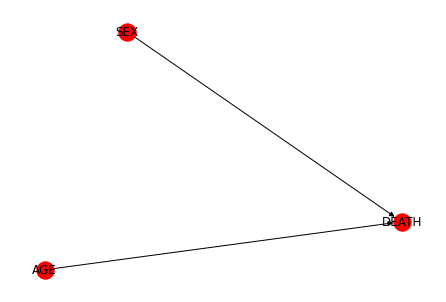

In [ ]:
import networkx as nx
n, d = bbn1.to_nx_graph()
nx.draw(n, with_labels=True, labels=d, node_color='r', alpha=1.0)

In [ ]:
# Define a function for printing marginal probabilities
def print_probs():
    for node in join_tree_1.get_bbn_nodes():
        potential = join_tree_1.get_bbn_potential(node)
        print("Node:", node)
        print("Values:")
        print(potential)
        print('----------------')
        
# Use the above function to print marginal probabilities
print_probs()

Node: 3|DEATH|0,1
Values:
3=0|0.87549
3=1|0.12451
----------------
Node: 4|SEX|Female,Male
Values:
4=Female|0.41397
4=Male|0.58603
----------------
Node: 0|AGE|80+ years,65-79 years,60-64 years,50-59 years,40-49 years,18-29 years,30-39 years
Values:
0=80+ years|0.00952
0=65-79 years|0.01446
0=60-64 years|0.02814
0=50-59 years|0.09719
0=40-49 years|0.08925
0=18-29 years|0.37816
0=30-39 years|0.38328
----------------


In [ ]:
# print the posterior probabilities
for node, posteriors in join_tree_1.get_posteriors().items():
 p = ', '.join([f'{val}={prob:.5f}' for val, prob in posteriors.items()])
 print(f'{node} : {p}')

DEATH : 0=0.87549, 1=0.12451
SEX : Female=0.41397, Male=0.58603
AGE : 80+ years=0.00952, 65-79 years=0.01446, 60-64 years=0.02814, 50-59 years=0.09719, 40-49 years=0.08925, 18-29 years=0.37816, 30-39 years=0.38328


In [ ]:
# To add evidence of events that happened so probability distribution can be recalculated
def evidence(ev, nod, cat, val):
    ev = EvidenceBuilder() \
    .with_node(join_tree_1.get_bbn_node_by_name(nod)) \
    .with_evidence(cat, val) \
    .build()
    join_tree_1.set_observation(ev)
    
# Use above function to add evidence
evidence('ev2','SEX','Male', 1.0)
evidence('ev3','AGE','30-39 years', 1.0)
#evidence('ev4','CARDIAC ARREST','1', 1.0)
#evidence('ev5','COMA','1', 1.0)

# Print marginal probabilities
print_probs()

Node: 3|DEATH|0,1
Values:
3=0|1.00000
3=1|0.00000
----------------
Node: 4|SEX|Female,Male
Values:
4=Female|0.00000
4=Male|1.00000
----------------
Node: 0|AGE|80+ years,65-79 years,60-64 years,50-59 years,40-49 years,18-29 years,30-39 years
Values:
0=80+ years|0.00000
0=65-79 years|0.00000
0=60-64 years|0.00000
0=50-59 years|0.00000
0=40-49 years|0.00000
0=18-29 years|0.00000
0=30-39 years|1.00000
----------------


In [ ]:
#pip install bn

In [ ]:
#import pymc3 as pm

In [ ]:
#from bn.bayesian_network import BayesianNetwork
#from bn.dag import DAG
#from bn.dag_prior import DAGPrior
#from bn.sampler import StructureMCMC
#from bn.variable import Variable

In [ ]:
#with pm.Model() as m:
    #dag = DAG(variables=[difficulty, grade, has_studied, letter, sat], adj=adj)
    #bn = BayesianNetwork('bn', dag=dag)

In [ ]:
#with m:    
    #data = pm.sample_prior_predictive(1000, random_seed=23)['bn']

In [ ]:
#with pm.Model():
    #dag = DAGPrior(
       # 'dag', variables=[difficulty, grade, has_studied, letter, sat])
 #   bn = BayesianNetwork('bn', dag=dag, observed=data)
 #   step = StructureMCMC([dag], data=data)
 #   trace = pm.sample(draws=5, tune=1, chains=1, cores=1,
 #                     step=step, random_seed=23)

In [ ]:
#best = trace['dag'][0].copy()
#best_score = -numpy.Inf
#numpy.random.seed(2)

#for i in range(100):
#    adj, score = step.random(adj)
#    if best_score < score:
#        best = adj.copy()
#        best_score = score

#Export data

In [ ]:
df_undrup_final.to_csv (r'covid-19_vaccine_Moderna_clean.csv', index = True, header=True)